<a href="https://colab.research.google.com/github/Anshikaa4/Project-Object-Detection-in-drones-using-openCV-and-python-/blob/main/object_detection_using_video.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Saving video.mp4 to video (1).mp4


Using cache found in /root/.cache/torch/hub/ultralytics_yolov5_master
YOLOv5 🚀 2024-6-8 Python-3.10.12 torch-2.3.0+cu121 CPU

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
Adding AutoShape... 


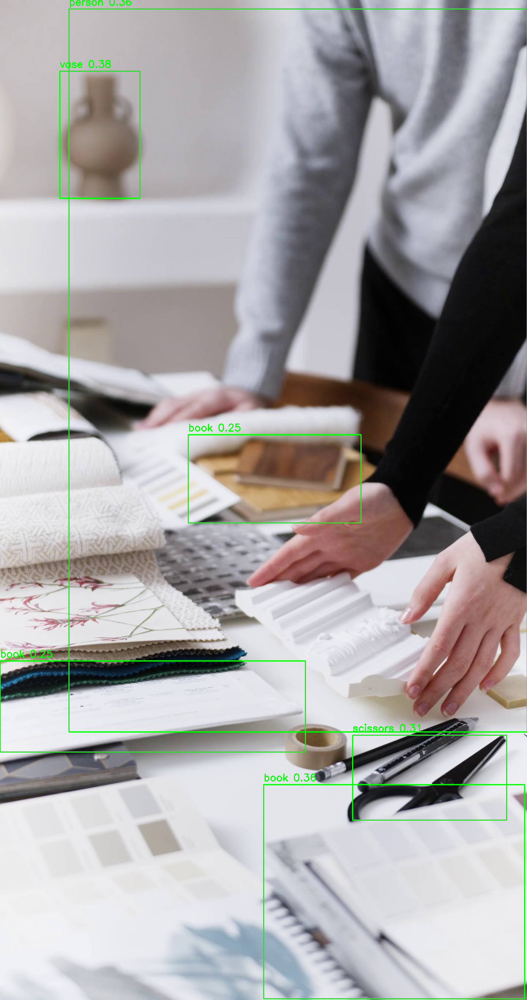

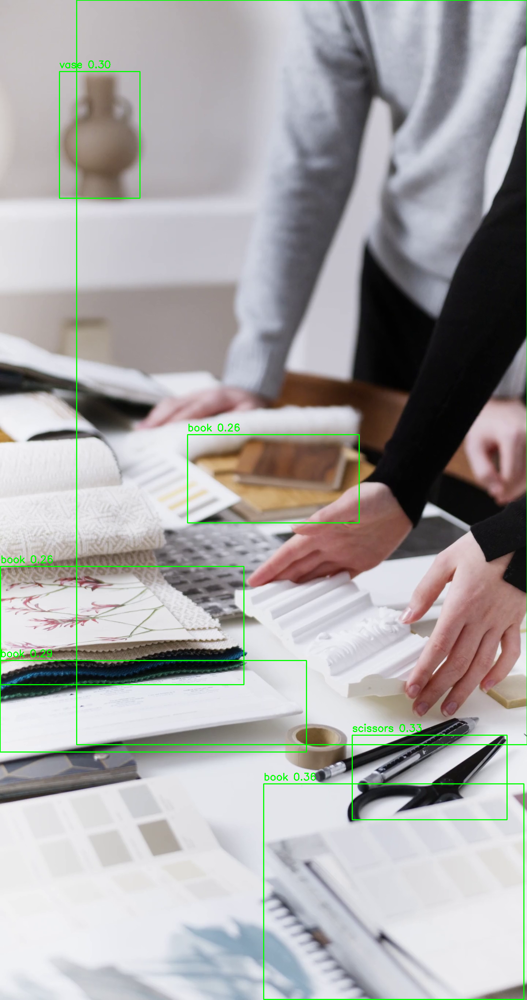

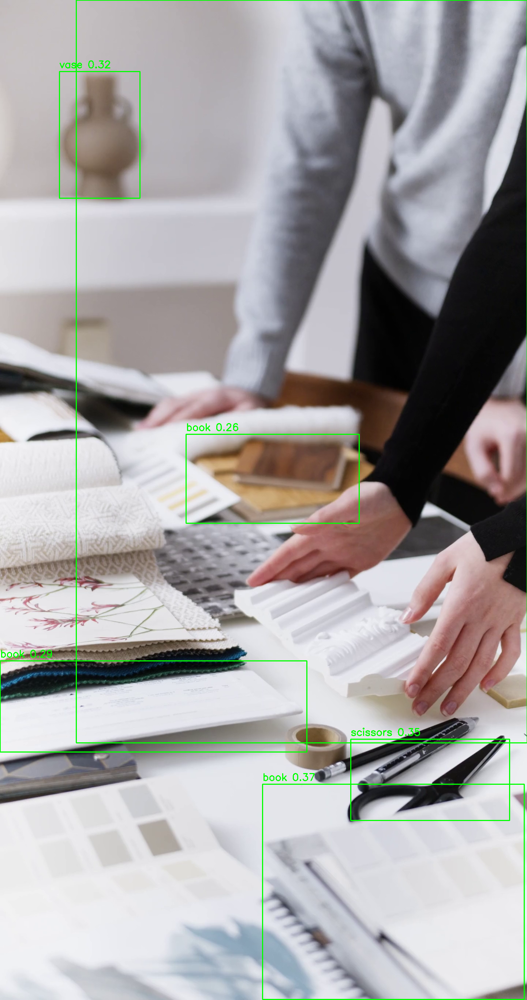

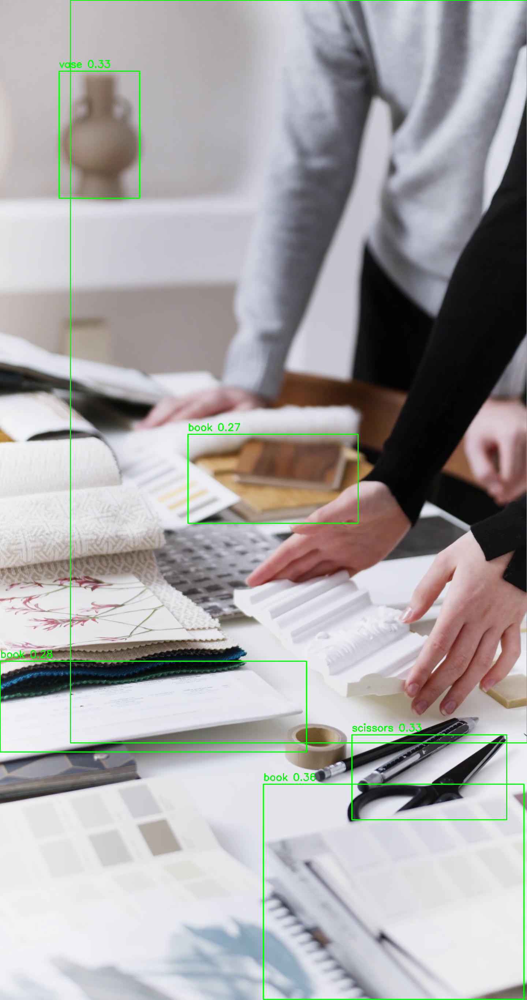

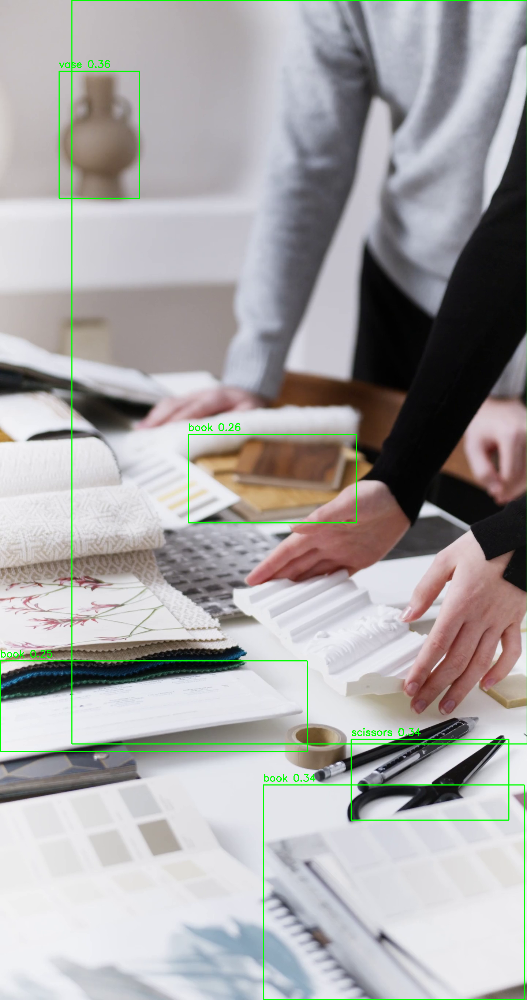

...

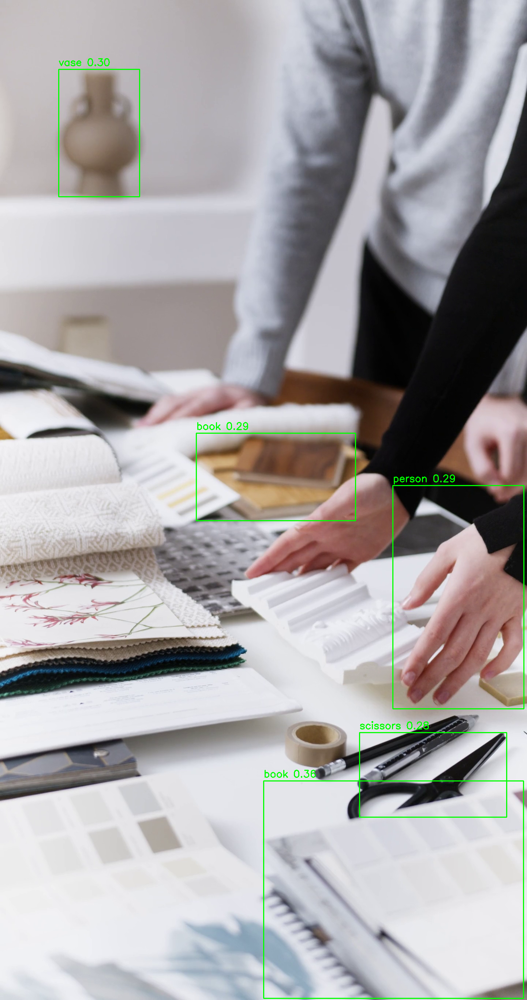

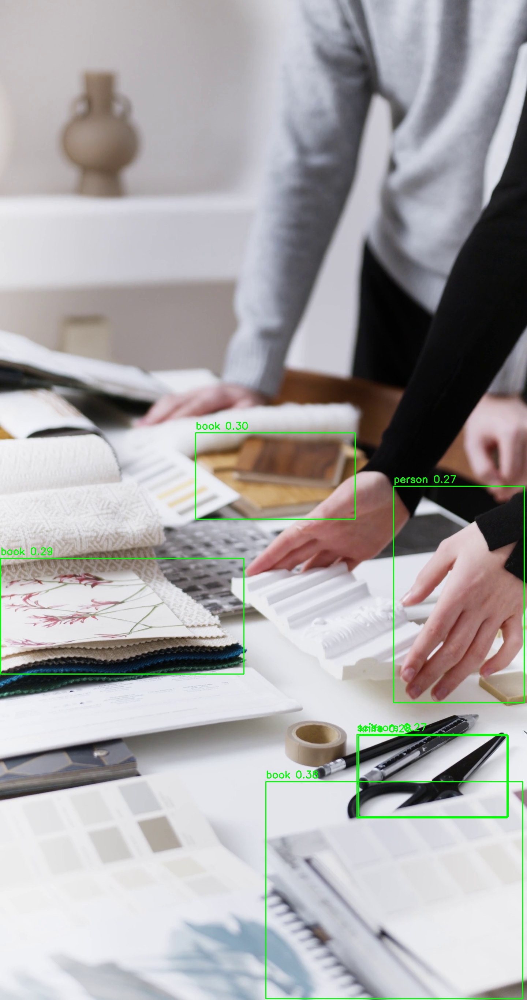

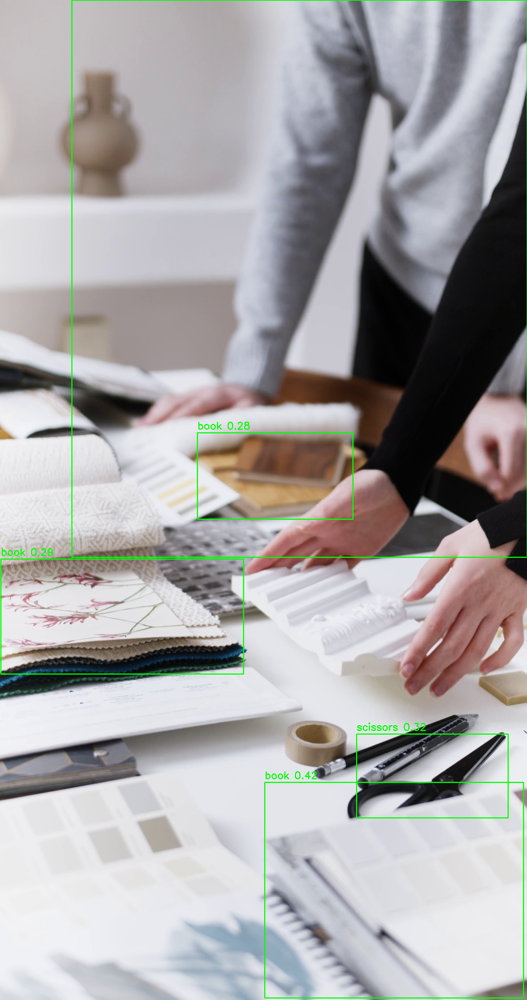

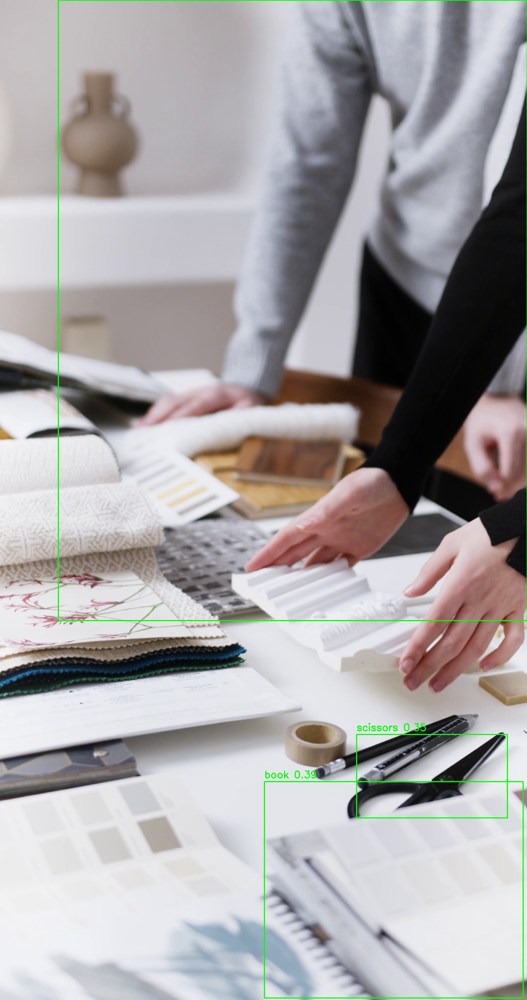

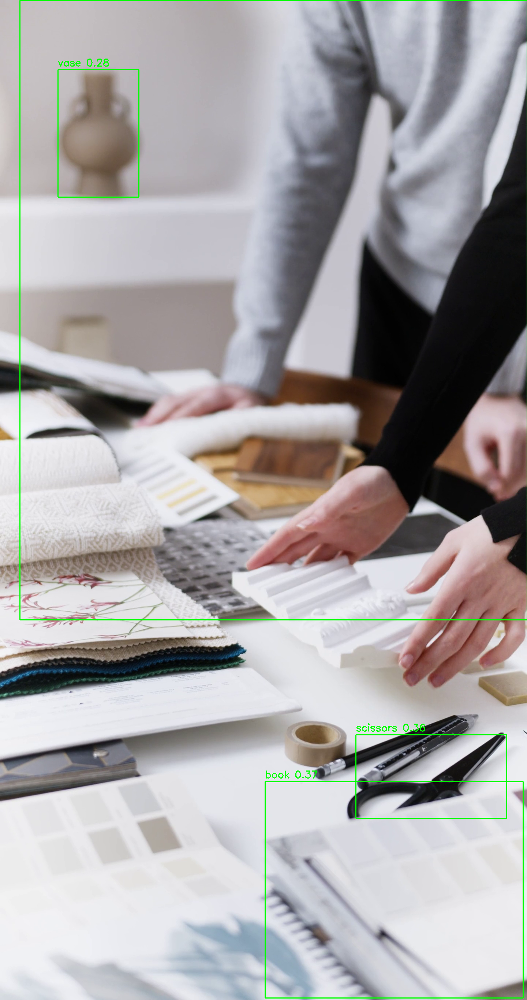

Buffered data was truncated after reaching the output size limit.

In [ ]:
# Step 1: Upload the video file
from google.colab import files
uploaded = files.upload()

# Step 2: Verify the uploaded file name
video_path = '/content/video.mp4'  # Replace with your uploaded video file name

# The rest of the script remains the same

import torch
import cv2
import pandas as pd
from datetime import datetime
from google.colab.patches import cv2_imshow

# Load YOLOv5 model
model = torch.hub.load('ultralytics/yolov5', 'yolov5s')

# Initialize video capture
cap = cv2.VideoCapture(video_path)

# Check if the video file is opened correctly
if not cap.isOpened():
    print("Error: Could not open video file.")
    exit()

# Initialize a list to store the detection results
detection_results = []

# Define a function to log detections to the CSV file
def log_detections(detection_results):
    df = pd.DataFrame(detection_results, columns=['Timestamp', 'Class', 'Confidence', 'X1', 'Y1', 'X2', 'Y2'])
    csv_path = 'detection_results.csv'
    df.to_csv(csv_path, index=False)
    print(f"Detection results saved to {csv_path}")

while cap.isOpened():
    # Capture frame-by-frame
    ret, frame = cap.read()
    if not ret:
        print("End of video file or error occurred.")
        break

    # Perform object detection
    results = model(frame)

    # Get the current timestamp
    timestamp = datetime.now().strftime('%Y-%m-%d %H:%M:%S')

    # Draw bounding boxes and labels on the frame and log results
    for result in results.xyxy[0].cpu().numpy():
        x1, y1, x2, y2, confidence, class_id = result
        class_name = results.names[int(class_id)]
        label = f"{class_name} {confidence:.2f}"
        cv2.rectangle(frame, (int(x1), int(y1)), (int(x2), int(y2)), (0, 255, 0), 2)
        cv2.putText(frame, label, (int(x1), int(y1) - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (0, 255, 0), 2)

        # Append the detection result to the list
        detection_results.append([timestamp, class_name, confidence, int(x1), int(y1), int(x2), int(y2)])

    # Display the resulting frame
    cv2_imshow(frame)

    # Break the loop if 'q' is pressed (in Colab, this won't work, so you can stop execution manually)
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# Release the video capture and close the window
cap.release()
cv2.destroyAllWindows()

# Log the detection results to the CSV file
log_detections(detection_results)
